# Setup

pip install `ultralytics` and [dependencies](https://github.com/ultralytics/ultralytics/blob/main/pyproject.toml) and check software and hardware.

[![PyPI - Version](https://img.shields.io/pypi/v/ultralytics?logo=pypi&logoColor=white)](https://pypi.org/project/ultralytics/) [![Downloads](https://static.pepy.tech/badge/ultralytics)](https://clickpy.clickhouse.com/dashboard/ultralytics) [![PyPI - Python Version](https://img.shields.io/pypi/pyversions/ultralytics?logo=python&logoColor=gold)](https://pypi.org/project/ultralytics/)

In [ ]:
!pip install -U ultralytics
import ultralytics
ultralytics.checks()

Ultralytics 8.3.227 🚀 Python-3.10.14 torch-2.4.0 CUDA:0 (Tesla T4, 15095MiB)
Setup complete ✅ (4 CPUs, 31.4 GB RAM, 6562.9/8062.4 GB disk)


# My Work

In [ ]:
# Loading Dataset from wej-yaanak
from datasets import load_dataset

ds = load_dataset("openfoodfacts/nutrition-table-detection")
ds

DatasetDict({
    train: Dataset({
        features: ['image_id', 'image', 'width', 'height', 'meta', 'objects'],
        num_rows: 1083
    })
    val: Dataset({
        features: ['image_id', 'image', 'width', 'height', 'meta', 'objects'],
        num_rows: 123
    })
})

In [ ]:
from ultralytics import YOLO
import os
import yaml
from pathlib import Path
from datasets import load_dataset

ds = load_dataset("openfoodfacts/nutrition-table-detection")
ds

# 1. Prepare your dataset (assuming ds is loaded and contains `train` and `validation` splits)
# You’ll need to export images and annotations in YOLO format (one .txt per image, etc.).
def export_to_yolo_format(ds_split, images_dir, labels_dir, class2id):
    os.makedirs(images_dir, exist_ok=True)
    os.makedirs(labels_dir, exist_ok=True)
    for i, example in enumerate(ds_split):
        img = example["image"]  # assuming PIL image or path
        img_path = os.path.join(images_dir, f"{i:06d}.jpg")
        img.save(img_path)

        # annotations: convert your format to YOLO txt format
        # YOLO format: class_id x_center y_center width height (relative to image size)
        w, h = img.size
        lines = []
        for bbox, label in zip(example["objects"]["bbox"], example["objects"]["category_name"]):
            x_min, y_min, x_max, y_max = bbox
            x_c = ((x_min + x_max) / 2) / w
            y_c = ((y_min + y_max) / 2) / h
            bb_w = (x_max - x_min) / w
            bb_h = (y_max - y_min) / h
            class_id = 0
            lines.append(f"{0} {x_c:.6f} {y_c:.6f} {bb_w:.6f} {bb_h:.6f}")

        label_path = os.path.join(labels_dir, f"{i:06d}.txt")
        with open(label_path, "w") as f:
            f.write("\n".join(lines))

# Example usage:
class_names = ['Product']
class2id = {"Product":0}

export_to_yolo_format(ds["train"], "data4/images/train", "data4/labels/train", class2id)
export_to_yolo_format(ds["val"], "data4/images/val", "data4/labels/val", class2id)

# 2. Create YAML config for YOLO11
data_cfg = {
    "path": "data4",                # root dir for images/labels
    "train": "images/train",       # relative path to train images
    "val": "images/val",           # relative path to val images
    "nc": len(class_names),        # number of classes
    "names": class_names           # list of class names
}
with open("data4/my_dataset.yaml", "w") as f:
    yaml.dump(data_cfg, f)

#

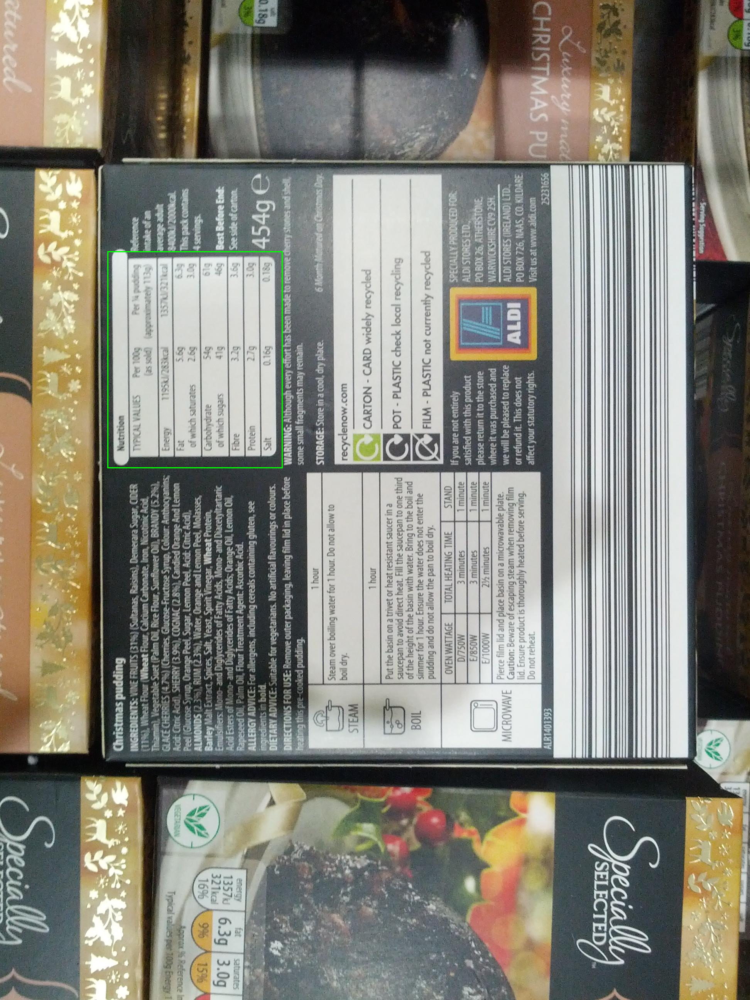

In [ ]:
from PIL import Image, ImageDraw

def draw_bbox_pil(image, bbox, normalized=True, color="lime", width=3):
    """
    Draws a bounding box on a PIL image.

    Args:
        image (PIL.Image): PIL image.
        bbox (list or tuple): 4 values → either [x_min, y_min, x_max, y_max]
                              or [x_center, y_center, w, h] if normalized=True.
        normalized (bool): Set True if bbox is in YOLO normalized format (0–1).
        color (str or tuple): Box color.
        width (int): Line width.
    """
    draw = ImageDraw.Draw(image)
    W, H = image.size

    # Convert from normalized YOLO format
    y_min, x_min, y_max, x_max  = bbox
    x_min *= W
    y_min *= H
    x_max *= W
    y_max *= H

    draw.rectangle([x_min, y_min, x_max, y_max], outline=color, width=width)
    return image

#ds["train"][4]['objects']['bbox'][0]

draw_bbox_pil( ds["train"][4]['image'], ds["train"][4]['objects']['bbox'][0])


In [ ]:
!rm -r data4

In [ ]:
from ultralytics import YOLO
import os
import yaml
from pathlib import Path
from datasets import load_dataset

ds = load_dataset("openfoodfacts/nutrition-table-detection")
ds

def convert_normalized_box_to_yolo(x_min, y_min, x_max, y_max, class_id=0):
    x_center = (x_min + x_max) / 2
    y_center = (y_min + y_max) / 2
    width = x_max - x_min
    height = y_max - y_min
    return f"{class_id} {x_center:.6f} {y_center:.6f} {width:.6f} {height:.6f}"

# 1. Prepare your dataset (assuming ds is loaded and contains `train` and `validation` splits)
# You’ll need to export images and annotations in YOLO format (one .txt per image, etc.).
def export_to_yolo_format(ds_split, images_dir, labels_dir, class2id):
    os.makedirs(images_dir, exist_ok=True)
    os.makedirs(labels_dir, exist_ok=True)
    for i, example in enumerate(ds_split):
        img = example["image"]  # assuming PIL image or path
        img_path = os.path.join(images_dir, f"{i:06d}.jpg")
        img.save(img_path)

        # annotations: convert your format to YOLO txt format
        # YOLO format: class_id x_center y_center width height (relative to image size)
        w, h = img.size
        lines = []
        bbox = example['objects']['bbox'][0]
        y_min, x_min, y_max, x_max  = bbox

        lines.append(convert_normalized_box_to_yolo(x_min, y_min, x_max, y_max ))

        label_path = os.path.join(labels_dir, f"{i:06d}.txt")
        with open(label_path, "w") as f:
            f.write("\n".join(lines))

# Example usage:
class_names = ['Product']
class2id = {"Product":0}

export_to_yolo_format(ds["train"], "data4/images/train", "data4/labels/train", class2id)
export_to_yolo_format(ds["val"], "data4/images/val", "data4/labels/val", class2id)

# 2. Create YAML config for YOLO11
data_cfg = {
    "path": "data4",                # root dir for images/labels
    "train": "images/train",       # relative path to train images
    "val": "images/val",           # relative path to val images
    "nc": len(class_names),        # number of classes
    "names": class_names           # list of class names
}
with open("data4/my_dataset.yaml", "w") as f:
    yaml.dump(data_cfg, f)

#

In [ ]:
!pip install

In [ ]:
from ultralytics import YOLO
model = YOLO("my_custom_yolo_model.pt")

ModuleNotFoundError: No module named 'ultralytics'

In [ ]:

# 4. Train
results = model.train(
    data="data4/my_dataset.yaml",
    epochs=10,
    imgsz=640,
    batch=32,
    device="cuda:0",  # or "cpu"
    workers=8
)

# 5. After training: validate / infer
metrics = model.val()
print(metrics.box.map)  # example metric

Ultralytics 8.3.226 🚀 Python-3.10.14 torch-2.4.0 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=32, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=data4/my_dataset.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=10, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train4, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, perspective=0.0, plots=True, pose=12.0, pretrained

In [ ]:


results = model(filename)
results[0].boxes.xywh[0].cpu()


image 1/1 /kaggle/working/google_logo.png: 480x640 2 Products, 9.2ms
Speed: 2.7ms preprocess, 9.2ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


tensor([1308.8942, 1003.6602,  249.4136,  725.2223])

In [ ]:
!pip install gdown

# Import the library
import gdown

# Paste the shareable link from Google Drive
# Make sure the link is set to "Anyone with the link" in Google Drive
url = 'https://drive.google.com/drive/folders/10IaByDjn9RLPTVDupadK62s2R72A7QoZ'

# Download the file (replace 'output.csv' with your desired filename)
gdown.download_folder(url, quiet=False)

Retrieving folder contents


Processing file 1w8FUdGkP6cdcOQXA9Tbtd5-_291DzMNW 20251107_201009.jpg
Processing file 1LyB94mPfsxBxWBEjgc0Fg06pmh2iIQuK 20251107_201017.jpg
Processing file 1Z1KDJ4Ud7nyWd3F0HooH3CMVtZkkLRcA 20251107_201042.jpg
Processing file 1bqUKBZgbUKZMaF2eanm0Z-DCwljfJ9gk 20251107_201118.jpg
Processing file 1bGPYkSP0d-9_oua9oQak_I6U8-hhH5Ri 20251107_201209.jpg
Processing file 1xIUvxeUJgzWb2-SKjbwL6hx0_poZ9v1H 20251107_201223.jpg
Processing file 1DTDQ7TjjY_hQOreBnVChfuEOW2uSndkv 20251107_201245.jpg
Processing file 1s9qiKAMFkCKt6gHfANz3tXDkMlR2Pxo4 20251107_201306.jpg
Processing file 1mG2F1FesmBjjSm9O3V3MyAQYtDS78F5Y 20251107_201336.jpg
Processing file 1mH5cpoKdFJ4v3k96Y1cBhfAs12Rx5LXc 20251107_201402.jpg
Processing file 19MV3I-Q2NgrS710m67ZFwxK2QHMOsKEo 20251107_201431.jpg
Processing file 1mTXqRzivgfQjQHGpmg4x5ELjjqBa9UaP 20251107_201537.jpg
Processing file 1Ev6OyuDHyhjq-4CrmOMtMLkmIQ5JLDve 20251107_201555.jpg
Processing file 19zpRYJCoXAPQTbs7UC5oAESzvr2kth8F 20251107_201612.jpg
Processing file 1J0w

Retrieving folder contents completed
Building directory structure
Building directory structure completed
Downloading...
From: https://drive.google.com/uc?id=1w8FUdGkP6cdcOQXA9Tbtd5-_291DzMNW
To: /kaggle/working/TunisianProductsImages/20251107_201009.jpg
100%|██████████| 2.73M/2.73M [00:00<00:00, 169MB/s]
Downloading...
From: https://drive.google.com/uc?id=1LyB94mPfsxBxWBEjgc0Fg06pmh2iIQuK
To: /kaggle/working/TunisianProductsImages/20251107_201017.jpg
100%|██████████| 2.86M/2.86M [00:00<00:00, 16.1MB/s]
Downloading...
From: https://drive.google.com/uc?id=1Z1KDJ4Ud7nyWd3F0HooH3CMVtZkkLRcA
To: /kaggle/working/TunisianProductsImages/20251107_201042.jpg
100%|██████████| 2.55M/2.55M [00:00<00:00, 53.6MB/s]
Downloading...
From: https://drive.google.com/uc?id=1bqUKBZgbUKZMaF2eanm0Z-DCwljfJ9gk
To: /kaggle/working/TunisianProductsImages/20251107_201118.jpg
100%|██████████| 3.44M/3.44M [00:00<00:00, 221MB/s]
Downloading...
From: https://drive.google.com/uc?id=1bGPYkSP0d-9_oua9oQak_I6U8-hhH5Ri
To:

['/kaggle/working/TunisianProductsImages/20251107_201009.jpg',
 '/kaggle/working/TunisianProductsImages/20251107_201017.jpg',
 '/kaggle/working/TunisianProductsImages/20251107_201042.jpg',
 '/kaggle/working/TunisianProductsImages/20251107_201118.jpg',
 '/kaggle/working/TunisianProductsImages/20251107_201209.jpg',
 '/kaggle/working/TunisianProductsImages/20251107_201223.jpg',
 '/kaggle/working/TunisianProductsImages/20251107_201245.jpg',
 '/kaggle/working/TunisianProductsImages/20251107_201306.jpg',
 '/kaggle/working/TunisianProductsImages/20251107_201336.jpg',
 '/kaggle/working/TunisianProductsImages/20251107_201402.jpg',
 '/kaggle/working/TunisianProductsImages/20251107_201431.jpg',
 '/kaggle/working/TunisianProductsImages/20251107_201537.jpg',
 '/kaggle/working/TunisianProductsImages/20251107_201555.jpg',
 '/kaggle/working/TunisianProductsImages/20251107_201612.jpg',
 '/kaggle/working/TunisianProductsImages/20251107_201654.jpg',
 '/kaggle/working/TunisianProductsImages/20251107_20170

In [ ]:
import cv2
import numpy as np

def flatten_cropped_document(image):
    """
    Flattens a cropped document image (assumes the document occupies the entire image,
    but may be photographed at an angle).
    """
    h, w = image.shape[:2]

    # Use the four corners of the image as the source points
    pts = np.array([
        [0, 0],        # top-left
        [w-1, 0],      # top-right
        [w-1, h-1],    # bottom-right
        [0, h-1]       # bottom-left
    ], dtype="float32")

    # Destination points — same as image size for a straightened rectangle
    dst = np.array([
        [0, 0],
        [w-1, 0],
        [w-1, h-1],
        [0, h-1]
    ], dtype="float32")

    # Compute perspective transform (identity in this case, but can correct slight angles)
    M = cv2.getPerspectiveTransform(pts, dst)
    warped = cv2.warpPerspective(image, M, (w, h))

    return warped

In [ ]:
import os
from ultralytics import YOLO
model = YOLO("my_custom_yolo_model.pt")



image 1/1 /kaggle/working/TunisianProductsImages/20251107_203102.jpg: 640x480 2 Products, 10.0ms
Speed: 3.0ms preprocess, 10.0ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 480)


<Figure size 640x480 with 0 Axes>

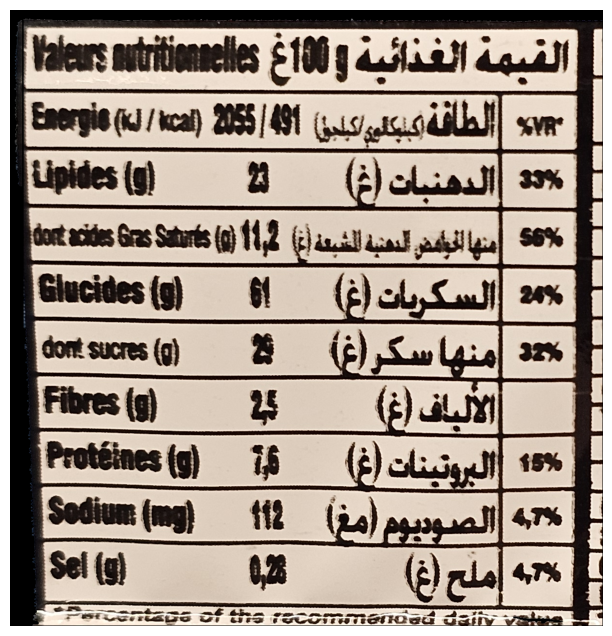

KeyboardInterrupt: 

<Figure size 640x480 with 0 Axes>

In [ ]:
import os
from ultralytics import YOLO
model = YOLO("my_custom_yolo_model.pt")

BSD = "TunisianProductsImages/"

for it in os.listdir("TunisianProductsImages")[4:]:
    crop_yolo_boxes(BSD + it)

In [ ]:
img = Image.open("TunisianProductsImages/20251107_202413.jpg")

plt.figure()
plt.imgshow(img)
plt.show()


image 1/1 /kaggle/working/TunisianProductsImages/20251107_202413.jpg: 640x480 2 Products, 8.4ms
Speed: 3.0ms preprocess, 8.4ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 480)
 

 

 

 



<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

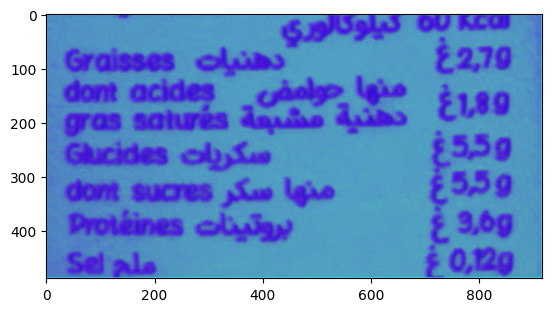

In [ ]:
import cv2
import numpy as np
import pytesseract


def testing_dynamic_foreground():
    images = crop_yolo_boxes("TunisianProductsImages/20251107_202413.jpg")

    img = images[0]

    # Optional: convert to grayscale for better OCR
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)


    # Optional: apply thresholding for cleaner text
    # _, gray = cv2.threshold(gray, 150, 255, cv2.THRESH_BINARY)

    # Extract text
    text = pytesseract.image_to_string(gray)
    print(text)
    plt.figure()
    plt.imshow(gray)
    plt.show()

def detect_text_tesseract(img):
    # Get bounding boxes for each word
    h, w = img.shape
    gray = img
    boxes = pytesseract.image_to_boxes(gray)

    for b in boxes.splitlines():
        b = b.split()
        x, y, x2, y2 = int(b[1]), int(b[2]), int(b[3]), int(b[4])
        # Tesseract's y-coordinates start from bottom
        y, y2 = h - y, h - y2
        cv2.rectangle(img, (x, y2), (x2, y), (0, 255, 0), 2)

    plt.figure()
    plt.imshow(img)
    plt.show()

testing_dynamic_foreground()

In [ ]:
!pip install paddleocr

/opt/conda/lib/python3.10/pty.py:89: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  pid, fd = os.forkpty()


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 51.4/51.4 kB 1.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.9/79.9 kB 4.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 40.4/40.4 kB 2.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.9/67.9 kB 4.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 86.7/86.7 kB 6.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.8/1.8 MB 32.2 MB/s eta 0:00:00a 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 63.0/63.0 kB 3.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.9/5.9 MB 80.3 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.0/3.0 MB 70.9 MB/s eta 0:00:00:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 199.4/199.4 kB 7.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 354.1/354.1 kB 22.0 MB/s eta 0:00:00


In [ ]:
!pip install paddlepaddle==2.6.3 -f https://www.paddlepaddle.org.cn/whl/mkl/stable.html


Looking in links: https://www.paddlepaddle.org.cn/whl/mkl/stable.html
ERROR: Could not find a version that satisfies the requirement paddlepaddle==2.6.3 (from versions: 2.6.1, 2.6.2, 3.0.0b0, 3.0.0b1, 3.0.0b2, 3.0.0rc0, 3.0.0rc1, 3.0.0, 3.1.0, 3.1.1, 3.2.0, 3.2.1)
ERROR: No matching distribution found for paddlepaddle==2.6.3


In [ ]:
!pip install easyocr


In [ ]:
# Initialize PaddleOCR instance
import easyocr
import cv2

reader = easyocr.Reader(["ar","fa","ur","ug","en"])  # French + Arabic
images = crop_yolo_boxes("TunisianProductsImages/20251107_202413.jpg")

img = images[0]
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
results = reader.readtext(img_rgb)
results_all=[]
for bbox, text, prob in results:
            results_all.append({
                'bbox': bbox,
                'text': text,
                'confidence': prob
            })
            pts = [tuple(map(int, point)) for point in bbox]
            cv2.polylines(img_rgb, [np.array(pts)], isClosed=True, color=(0,255,0), thickness=2)
            # Optional: put recognized text above box
            cv2.putText(img_rgb, text, (pts[0][0], pts[0][1]-10),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0,0,255), 2)



image 1/1 /kaggle/working/TunisianProductsImages/20251107_202413.jpg: 640x480 2 Products, 9.0ms
Speed: 3.0ms preprocess, 9.0ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 480)


<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

In [ ]:
images = crop_yolo_boxes("TunisianProductsImages/20251107_202413.jpg")

img = images[0]
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

In [ ]:

images = crop_yolo_boxes("TunisianProductsImages/20251107_202413.jpg")

img = images[0]
img_pil = Image.fromarray(img)  # convert to PIL



image 1/1 /kaggle/working/TunisianProductsImages/20251107_202413.jpg: 640x480 2 Products, 9.2ms
Speed: 3.0ms preprocess, 9.2ms inference, 2.4ms postprocess per image at shape (1, 3, 640, 480)


<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>


image 1/1 /kaggle/working/TunisianProductsImages/20251107_202413.jpg: 640x480 2 Products, 11.0ms
Speed: 9.3ms preprocess, 11.0ms inference, 2.8ms postprocess per image at shape (1, 3, 640, 480)


<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

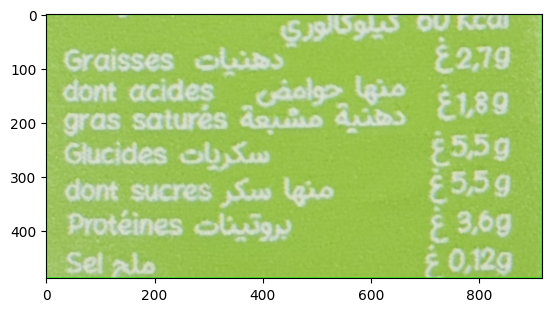

In [ ]:

images2 = crop_yolo_boxes("TunisianProductsImages/20251107_202413.jpg")

img2 = images2[0]
img_pil2 = Image.fromarray(img2)  # convert to PIL


plt.figure()
plt.imshow(img_pil2)
plt.show()

In [ ]:
from transformers import AutoModelForCausalLM, AutoTokenizer
from PIL import Image

model_ocr_moon = AutoModelForCausalLM.from_pretrained(
    "vikhyatk/moondream2",
    revision="2025-06-21",
    trust_remote_code=True,
    device_map={"": "cuda"}  # ...or 'mps', on Apple Silicon
)


tokenizer_moon = AutoTokenizer.from_pretrained("vikhyatk/moondream2", revision="2025-06-21")


In [ ]:
!pip uninstall -y torch torchvision torchaudio
!pip install torch torchvision torchaudio --force-reinstall --index-url https://download.pytorch.org/whl/cu121


Found existing installation: torch 2.5.1+cu121
Uninstalling torch-2.5.1+cu121:
  Successfully uninstalled torch-2.5.1+cu121
Found existing installation: torchvision 0.20.1+cu121
Uninstalling torchvision-0.20.1+cu121:
  Successfully uninstalled torchvision-0.20.1+cu121
Found existing installation: torchaudio 2.5.1+cu121
Uninstalling torchaudio-2.5.1+cu121:
  Successfully uninstalled torchaudio-2.5.1+cu121
Looking in indexes: https://download.pytorch.org/whl/cu121
  Using cached https://download.pytorch.org/whl/cu121/torch-2.5.1%2Bcu121-cp310-cp310-linux_x86_64.whl (780.4 MB)
  Using cached https://download.pytorch.org/whl/cu121/torchvision-0.20.1%2Bcu121-cp310-cp310-linux_x86_64.whl (7.3 MB)
  Using cached https://download.pytorch.org/whl/cu121/torchaudio-2.5.1%2Bcu121-cp310-cp310-linux_x86_64.whl (3.4 MB)
  Using cached https://download.pytorch.org/whl/cu121/nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached https://download.pytorch.org/whl/cu121/nv

In [ ]:

# --- Encode image for the model ---
enc_image = model_ocr_moon.encode_image(img_pil)

# --- Ask the model to read the text ---
prompt = "Extract all visible text exactly as it appears."
response = model_ocr_moon.answer_question(enc_image, prompt, tokenizer)

print("🧾 OCR Result:")

TypeError: scaled_dot_product_attention() got an unexpected keyword argument 'enable_gqa'

In [ ]:
import torch
print(torch.__version__)


In [ ]:
import torch

if hasattr(torch.nn.functional, 'scaled_dot_product_attention') and \
   'enable_gqa' in torch.nn.functional.scaled_dot_product_attention.__code__.co_varnames:
    # Use enable_gqa if supported
    output = torch.nn.functional.scaled_dot_product_attention(
        query, key, value, enable_gqa=True
    )
else:
    # Fallback for older versions
    output = torch.nn.functional.scaled_dot_product_attention(
        query, key, value
    )

AttributeError: 'builtin_function_or_method' object has no attribute '__code__'

In [ ]:

# --- Read your image with OpenCV ---
img = cv2.imread("sample.jpg")
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # convert to RGB
pil_img = Image.fromarray(img)  # convert to PIL

# --- Encode the image using the model ---
enc_image = model.encode_image(pil_img)

# --- Query for text extraction ---
question = "Extract all readable text from this image."
response = model.answer_question(enc_image, question, tokenizer)

print("🧾 Extracted text:")
print(response)


In [ ]:
import cv2
import torch
from PIL import Image
from transformers import AutoModelForCausalLM, AutoTokenizer

# --- Load model and tokenizer ---
model_id = "vikhyatk/moondream2"
model = AutoModelForCausalLM.from_pretrained(model_id, torch_dtype=torch.float16, device_map="auto")
tokenizer = AutoTokenizer.from_pretrained(model_id)

# --- Read your image with OpenCV ---
img = cv2.imread("sample.jpg")
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # convert to RGB
pil_img = Image.fromarray(img)  # convert to PIL

# --- Encode the image using the model ---
enc_image = model.encode_image(pil_img)

# --- Query for text extraction ---
question = "Extract all readable text from this image."
response = model.answer_question(enc_image, question, tokenizer)

print("🧾 Extracted text:")
print(response)


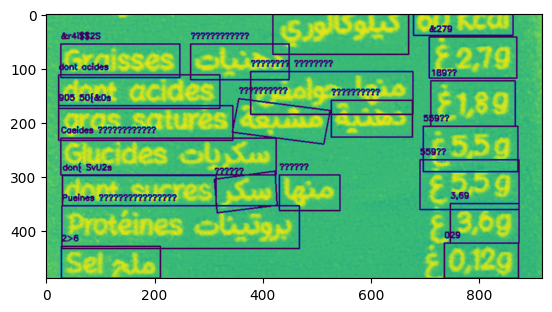

In [ ]:
plt.figure()
plt.imshow(img_rgb)
plt.show()


image 1/1 /kaggle/working/TunisianProductsImages/20251107_202413.jpg: 640x480 2 Products, 9.1ms
Speed: 2.9ms preprocess, 9.1ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 480)


<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

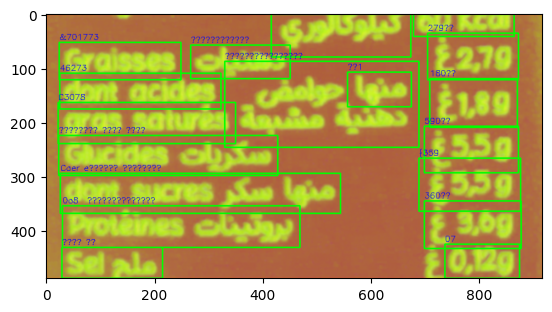

مدری 0.04298929497599602
 0.0
&701773 0.02984283484397308
لانیاد 0.02012360328754767
279غ 0.40955859422683716
46273 0.11872241391263846
تفقچطفقہ 0.028728339378691937
م1 0.03847612434906452
180غ 0.6704720258712769
C3078 0.004863692564423287
٠«٥١ ٥، ٤٣ 0.004809264096339859
590غ 0.1069805845618248
Caer eمها مكره 0.01870405237832437
{359 0.44387808442115784
0o8  برتبنات 0.01807601205268999
360غ 0.14817482233047485
٦٧ ؟ 0.08127158135175705
07 0.5588318674111942


In [ ]:
import cv2
import numpy as np
import easyocr

reader = easyocr.Reader(["ar","fa","ur","ug","en"])

def preprocess_and_ocr(img_path):
    """
    Preprocesses an image to make faint colored text more visible and runs OCR.
    """
    # Load image
    images = crop_yolo_boxes("TunisianProductsImages/20251107_202413.jpg")

    img = images[0]
    # Convert to HSV to isolate yellow text
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)


    # Invert mask: text becomes black on white
    mask_inv = cv2.bitwise_not(hsv)

    # Optional: dilate to connect letters
    kernel = np.ones((3,3), np.uint8)
    mask_inv = cv2.dilate(mask_inv, kernel, iterations=1)

    # Optional: Gaussian blur to reduce noise
    processed = cv2.GaussianBlur(mask_inv, (3,3), 0)

    # Run OCR
    results = reader.readtext(processed)

    # Draw boxes
    for bbox, text, prob in results:
        pts = [tuple(map(int, point)) for point in bbox]
        cv2.polylines(processed, [np.array(pts)], isClosed=True, color=(0,255,0), thickness=2)
        cv2.putText(processed, text, (pts[0][0], pts[0][1]-5),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0,0,255), 1)

    return processed, results

# Example usage
output_img, ocr_results = preprocess_and_ocr("/mnt/data/ebd57c47-b987-4d9e-9c54-b61c55cd0ac4.png")

plt.figure()
plt.imshow( output_img)
plt.show()
# Print detected text
for _, text, prob in ocr_results:
    print(text, prob)



image 1/1 /kaggle/working/TunisianProductsImages/20251107_202413.jpg: 640x480 2 Products, 9.6ms
Speed: 2.9ms preprocess, 9.6ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 480)
[{'bbox': [[426, 0], [868, 0], [868, 64], [426, 64]], 'text': "5855YOE'EEWE", 'confidence': 0.027891578502325216}, {'bbox': [[30, 55], [247, 55], [247, 115], [30, 115]], 'text': 'Grdssës', 'confidence': 0.23600282442875434}, {'bbox': [[270, 58], [446, 58], [446, 114], [270, 114]], 'text': '2555', 'confidence': 0.4277716279029846}, {'bbox': [[753, 55], [869, 55], [869, 117], [753, 117]], 'text': '2779', 'confidence': 0.7185823321342468}, {'bbox': [[27, 113], [322, 113], [322, 177], [27, 177]], 'text': '@{uèGetës', 'confidence': 0.017604799454762066}, {'bbox': [[420, 116], [536, 116], [536, 170], [420, 170]], 'text': '29a ', 'confidence': 0.025254108011722565}, {'bbox': [[716, 133], [865, 133], [865, 202], [716, 202]], 'text': '8180', 'confidence': 0.140826016664505}, {'bbox': [[31, 171], [341, 171

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

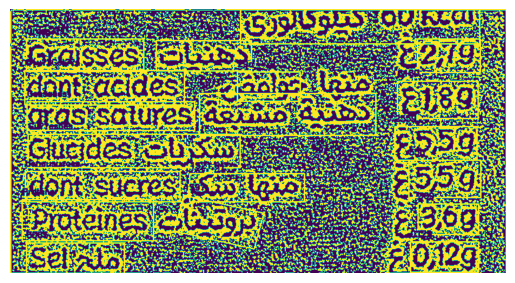

In [ ]:
import cv2
import pytesseract
import numpy as np

def ocr_color_text(image_path, use_color_mask=False,color_lower=(5, 5, 5), color_upper=(7, 25, 255), lang='fra+ara'):
    """
    Perform OCR on text of a specific color in an image.

    Args:
        image_path (str): Path to the input image.
        color_lower (tuple): Lower HSV bound for text color.
        color_upper (tuple): Upper HSV bound for text color.
        lang (str): Languages for Tesseract OCR (default 'fra+ara').

    Returns:
        str: Detected text.
        np.ndarray: Processed image used for OCR (for visualization/debugging).
    """
    images = crop_yolo_boxes("TunisianProductsImages/20251107_202413.jpg")
    # Load image
    img = images[0]
    if img is None:
        raise ValueError(f"Image at {image_path} not found.")

    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Apply CLAHE to enhance contrast

    # Adaptive thresholding to get binary image
    binary = cv2.adaptiveThreshold(
        gray, 255,
        cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
        cv2.THRESH_BINARY,
        11, 2
    )

    # Ensure black text on white background
    processed = cv2.bitwise_not(binary)

    # Morphological operations to improve text
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (2,2))
    processed = cv2.dilate(processed, kernel, iterations=1)

    # OCR
    reader = easyocr.Reader(["fr"])  # French + Arabic

    results = reader.readtext(processed)
    results_all=[]
    for bbox, text, prob in results:
                results_all.append({
                    'bbox': bbox,
                    'text': text,
                    'confidence': prob
                })
                pts = [tuple(map(int, point)) for point in bbox]
                cv2.polylines(processed, [np.array(pts)], isClosed=True, color=(255,255,255), thickness=2)
                # Optional: put recognized text above box
                cv2.putText(processed, text, (pts[0][0], pts[0][1]-10),
                            cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0,0,255), 2)

    return results_all, processed
# Example usage
text, processed_img = ocr_color_text("/mnt/data/34156d6b-ad65-493c-b3c7-8c84e0ee3906.png")
print(text)
plt.figure()
plt.imshow(processed_img)
plt.axis('off')
plt.show()


In [ ]:
!sudo apt install tesseract-ocr tesseract-ocr-fra tesseract-ocr-ara -y
!export TESSDATA_PREFIX=/usr/share/tesseract-ocr/4.00/tessdata/

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
tesseract-ocr is already the newest version (4.1.1-2.1build1).
The following NEW packages will be installed:
  tesseract-ocr-ara tesseract-ocr-fra
0 upgraded, 2 newly installed, 0 to remove and 68 not upgraded.
Need to get 1172 kB of archives.
After this operation, 2592 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy/universe amd64 tesseract-ocr-ara all 1:4.00~git30-7274cfa-1.1 [645 kB]
Get:2 http://archive.ubuntu.com/ubuntu jammy/universe amd64 tesseract-ocr-fra all 1:4.00~git30-7274cfa-1.1 [527 kB]
Fetched 1172 kB in 0s (3854 kB/s)          

78Selecting previously unselected package tesseract-ocr-ara.
(Reading database ... 122996 files and directories currently installed.)
Preparing to unpack .../tesseract-ocr-ara_1%3a4.00~git30-7274cfa-1.1_all.deb ...
7Progress: [  0%] [..........................................................] 87Progress: [ 

In [ ]:

import cv2
import matplotlib.pyplot as plt

def draw_yolo_boxes(image_path):
    # Run YOLO model
    results = model(image_path)

    # Load image
    img = cv2.imread(image_path)
    if img is None:
        raise FileNotFoundError(f"Image not found: {image_path}")

    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # Loop over all detected boxes
    for box in results[0].boxes.xywh.cpu().numpy():
        x_c, y_c, w, h = box
        x1 = int(x_c - w/2)
        y1 = int(y_c - h/2)
        x2 = int(x_c + w/2)
        y2 = int(y_c + h/2)

        # Draw rectangle
        cv2.rectangle(img, (x1, y1), (x2, y2), color=(0,255,0), thickness=2)

    # Show image inline
    plt.figure(figsize=(10,8))
    plt.imshow(img)
    plt.axis('off')
    plt.show()

    return img


draw_yolo_boxes(filename)

NameError: name 'filename' is not defined

In [ ]:
def testing_grab(img):
    mask = np.zeros(img.shape[:2],np.uint8)
    bgdModel = np.zeros((1,65),np.float64)
    fgdModel = np.zeros((1,65),np.float64)
    rect = (5,5,img.shape[1]-5,img.shape[0]-5)
    cv2.grabCut(img,mask,rect,bgdModel,fgdModel,5,cv2.GC_INIT_WITH_RECT)
    mask2 = np.where((mask==2)|(mask==0),0,1).astype('uint8')
    img = img*mask2[:,:,np.newaxis]
    plt.figure(figsize=(10,8))
    plt.imshow(img)
    plt.axis('off')
    plt.show()
    return img

In [ ]:
import cv2
import pytesseract

# Load image (already cropped or flattened)
img = cv2.imread("document.jpg")

# Optional: convert to grayscale for better OCR
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# Optional: apply thresholding for cleaner text
# _, gray = cv2.threshold(gray, 150, 255, cv2.THRESH_BINARY)

# Extract text
text = pytesseract.image_to_string(gray)
print(text)


In [ ]:
!sudo apt install tesseract-ocr
!pip install pytesseract


/opt/conda/lib/python3.10/pty.py:89: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  pid, fd = os.forkpty()


Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
tesseract-ocr is already the newest version (4.1.1-2.1build1).
0 upgraded, 0 newly installed, 0 to remove and 68 not upgraded.


In [ ]:
import cv2
import matplotlib.pyplot as plt
import cv2
import numpy as np
#from craft_text_detector import Craft
#import easyocr
from PIL import Image

def crop_yolo_boxes(image_path):
    # Run YOLO model
    results = model(image_path)

    # Load image
    img = cv2.imread(image_path)
    if img is None:
        raise FileNotFoundError(f"Image not found: {image_path}")
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    cropped_images = []

    # Loop over all detected boxes
    for i, box in enumerate(results[0].boxes.xywh.cpu().numpy()):
        x_c, y_c, w, h = box
        x1 = int(x_c - w/2)
        y1 = int(y_c - h/2)
        x2 = int(x_c + w/2)
        y2 = int(y_c + h/2)

        # Crop the box from the original image
        cropped = img_rgb[y1:y2, x1:x2]
        cropped_images.append(cropped)

        # Draw rectangle on original image
        cv2.rectangle(img_rgb, (x1, y1), (x2, y2), (0, 255, 0), 2)

    # Show the original image with rectangles
    #plt.figure(figsize=(10,8))
    #plt.imshow(img_rgb)
    #plt.axis('off')
    #plt.show()

    # Show cropped images
    for i, crop in enumerate(cropped_images):
        plt.figure()
        color_converted_image = cv2.cvtColor(crop, cv2.COLOR_BGR2RGB)
    # 3. Create a PIL Image object from the RGB NumPy array
        #crop = flatten_cropped_document(crop)
        pil_image = Image.fromarray(color_converted_image)
        #pil_image = auto_deskew(pil_image)
        #testing_grab(crop)
        #print("TEXT CROP " + str(i))
        #extract_text_donut(pil_image)
        #plt.imshow(crop)
        #plt.axis('off')
        #plt.title(f"Cropped Box {i}")
        #plt.show()

    return cropped_images

#result = crop_yolo_boxes(filename)

In [ ]:
from transformers import TrOCRProcessor, VisionEncoderDecoderModel
import requests
from PIL import Image

processor = TrOCRProcessor.from_pretrained("microsoft/trocr-base-handwritten")
model_ocr = VisionEncoderDecoderModel.from_pretrained("microsoft/trocr-base-handwritten")


def extract_text(image):
    image = image.convert("RGB")


    pixel_values = processor(image, return_tensors="pt").pixel_values
    generated_ids = model_ocr.generate(pixel_values)

    generated_text = processor.batch_decode(generated_ids, skip_special_tokens=True)[0]

    print(generated_text)


preprocessor_config.json:   0%|          | 0.00/224 [00:00<?, ?B/s]

tokenizer_config.json: 0.00B [00:00, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

special_tokens_map.json:   0%|          | 0.00/772 [00:00<?, ?B/s]

/opt/conda/lib/python3.10/site-packages/transformers/tokenization_utils_base.py:1617: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be deprecated in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


config.json: 0.00B [00:00, ?B/s]

model.safetensors:   0%|          | 0.00/1.33G [00:00<?, ?B/s]

VisionEncoderDecoderModel has generative capabilities, as `prepare_inputs_for_generation` is explicitly overwritten. However, it doesn't directly inherit from `GenerationMixin`. From 👉v4.50👈 onwards, `PreTrainedModel` will NOT inherit from `GenerationMixin`, and this model will lose the ability to call `generate` and other related functions.
  - If you're using `trust_remote_code=True`, you can get rid of this warning by loading the model with an auto class. See https://huggingface.co/docs/transformers/en/model_doc/auto#auto-classes
  - If you are the owner of the model architecture code, please modify your model class such that it inherits from `GenerationMixin` (after `PreTrainedModel`, otherwise you'll get an exception).
  - If you are not the owner of the model architecture class, please contact the model code owner to update it.
Some weights of VisionEncoderDecoderModel were not initialized from the model checkpoint at microsoft/trocr-base-handwritten and are newly initialized: ['

generation_config.json:   0%|          | 0.00/190 [00:00<?, ?B/s]

In [ ]:
import cv2
import numpy as np
from craft_text_detector import Craft
import easyocr
from PIL import Image

# Initialize CRAFT (text detection)
craft = Craft(output_dir=None, crop_type="poly")  # crops each text region

# Initialize EasyOCR (text recognition)
reader = easyocr.Reader(['en', 'ar', 'fr'], gpu=True)  # use 'gpu=False' if no CUDA

def extract_text(image):

    # Detect text regions with CRAFT
    prediction_result = craft.detect_text(image)

    text_results = []

    # Iterate through cropped boxes
    for crop_info in prediction_result["crops"]:
        # crop_info is a PIL Image
        pil_crop = crop_info["image"]

        # Convert to numpy for EasyOCR
        crop_array = np.array(pil_crop)

        # Recognize text with EasyOCR
        ocr_results = reader.readtext(crop_array)
        for (_, text, prob) in ocr_results:
            text_results.append((text, prob))

    # Release CRAFT resources
    craft.unload_craftnet_model()
    craft.unload_refinenet_model()

    return text_results


In [ ]:
!pip install easyocr
!pip install craft-text-detector


/opt/conda/lib/python3.10/pty.py:89: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  pid, fd = os.forkpty()


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.3/60.3 MB 21.7 MB/s eta 0:00:0000:0100:01m
  Attempting uninstall: opencv-python
    Found existing installation: opencv-python 4.10.0.84
    Uninstalling opencv-python-4.10.0.84:
      Successfully uninstalled opencv-python-4.10.0.84
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
ultralytics 8.3.226 requires opencv-python>=4.6.0, but you have opencv-python 4.5.4.60 which is incompatible.


In [ ]:
import cv2
import numpy as np
from PIL import Image

def auto_deskew(pil_image):
    # Convert PIL to OpenCV
    img = cv2.cvtColor(np.array(pil_image), cv2.COLOR_RGB2BGR)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    gray = cv2.bitwise_not(gray)  # text white, background black

    # Threshold
    thresh = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY | cv2.THRESH_OTSU)[1]

    # Find text coordinates
    coords = np.column_stack(np.where(thresh > 0))
    angle = cv2.minAreaRect(coords)[-1]

    # Correct the angle
    if angle < -45:
        angle = -(90 + angle)
    else:
        angle = -angle

    # Rotate image
    (h, w) = img.shape[:2]
    center = (w // 2, h // 2)
    M = cv2.getRotationMatrix2D(center, angle, 1.0)
    rotated = cv2.warpAffine(img, M, (w, h), flags=cv2.INTER_CUBIC, borderMode=cv2.BORDER_REPLICATE)

    # Convert back to PIL
    return Image.fromarray(cv2.cvtColor(rotated, cv2.COLOR_BGR2RGB))


In [ ]:
from transformers import DonutProcessor, VisionEncoderDecoderModel
from PIL import Image
import requests

# Load model and processor
model_name = "naver-clova-ix/donut-base-finetuned-cord-v2"  # Donut variant for documents
processor = DonutProcessor.from_pretrained(model_name)
model_ocr = VisionEncoderDecoderModel.from_pretrained(model_name)


def extract_text_donut(image):

    # Load your image
    image_url = "https://upload.wikimedia.org/wikipedia/commons/8/89/Example_document.png"
    image = image.convert("RGB")

    # Donut requires a prompt (task-specific)
    prompt = "<s_doc>"

    # Preprocess
    pixel_values = processor(image, return_tensors="pt").pixel_values

    # Generate output
    generated_ids = model_ocr.generate(
        pixel_values,
        decoder_input_ids=processor.tokenizer(prompt, return_tensors="pt").input_ids
    )

    # Decode text
    output_text = processor.batch_decode(generated_ids, skip_special_tokens=True)[0]

    print("Extracted text:\n", output_text)


In [ ]:
model = YOLO('my_custom_yolo_model.pt')

In [ ]:
import requests
import requests
import shutil

image_url = "https://scontent.ftun9-1.fna.fbcdn.net/v/t1.15752-9/575933350_2229700950871107_7663794119338447142_n.jpg?stp=dst-jpg_s2048x2048_tt6&_nc_cat=104&ccb=1-7&_nc_sid=9f807c&_nc_ohc=WBsq-HGecBYQ7kNvwEfn5MD&_nc_oc=AdnYIt0Rrvo09-ukaHuvu-KmZqjhWDarAuMVC-gyZYPN4GB30-M607rJ4vtmrBeHZqE&_nc_zt=23&_nc_ht=scontent.ftun9-1.fna&oh=03_Q7cD3wFl8ZG7-DWRugKCjaxkDr0__NLCw1iuyvWmctq-trdF3g&oe=693880F6"
filename = "google_logo.png"

response = requests.get(image_url, stream=True)
response.raise_for_status()  # Raise an HTTPError for bad responses (4xx or 5xx)
with open(filename, 'wb') as f:
    response.raw.decode_content = True  # Handle gzip/deflate encoding
    shutil.copyfileobj(response.raw, f)
print(f"Image successfully downloaded as {filename}")


Image successfully downloaded as google_logo.png


In [ ]:
import cv2
import numpy as np

def draw_yolo_boxes(image_path, label_path, class_names=None, color=(0, 255, 0), thickness=2):
    """
    Draws YOLO-format bounding boxes on an image.

    Args:
        image_path (str): Path to the image.
        label_path (str): Path to the YOLO-format label file.
        class_names (list, optional): List of class names (for display).
        color (tuple, optional): Box color in BGR.
        thickness (int, optional): Line thickness.

    Returns:
        np.ndarray: Image with bounding boxes drawn.
    """
    # Load image
    img = cv2.imread(image_path)
    if img is None:
        raise FileNotFoundError(f"Image not found: {image_path}")

    h, w = img.shape[:2]

    # Read YOLO label file
    with open(label_path, "r") as f:
        lines = f.read().strip().splitlines()

    for line in lines:
        cls, x_center, y_center, width, height = map(float, line.split())
        cls = int(cls)

        # Convert from relative to absolute pixel coordinates
        x_center, y_center, width, height = (
            x_center * w, y_center * h, width * w, height * h
        )
        x1 = int(x_center - width / 2)
        y1 = int(y_center - height / 2)
        x2 = int(x_center + width / 2)
        y2 = int(y_center + height / 2)

        # Draw rectangle
        cv2.rectangle(img, (x1, y1), (x2, y2), color, thickness)

        # Label text
        if class_names and 0 <= cls < len(class_names):
            text = class_names[cls]
            cv2.putText(img, text, (x1, y1 - 5), cv2.FONT_HERSHEY_SIMPLEX,
                        0.6, color, 2, cv2.LINE_AA)

    return img


draw_yolo_boxes()


0: 480x640 1 Product, 9.0ms
Speed: 2.9ms preprocess, 9.0ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


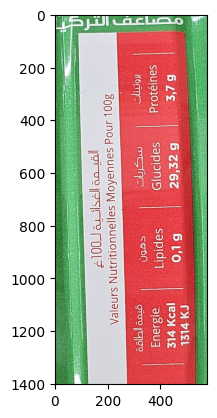

In [ ]:
from flask import Flask, request, jsonify, send_file
from ultralytics import YOLO
import cv2
import numpy as np
from PIL import Image
import io
import base64
import os

app = Flask(__name__)

# Load the YOLO model
model = YOLO('my_custom_yolo_model.pt')

@app.route('/health', methods=['GET'])
def health_check():
    """Health check endpoint"""
    return jsonify({"status": "healthy", "model_loaded": True})

#@app.route('/detect', methods=['POST'])
def detect_objects(image):
    """
    Detect objects in uploaded image and return image with bounding boxes
    """
    try:
        # Check if image file is present
        #if 'image' not in request.files:
        #    return jsonify({"error": "No image file provided"}), 400

        #file = request.files['image']
        #if file.filename == '':
        #    return jsonify({"error": "No image file selected"}), 400

        # Read image
        #image_bytes = file.read()
        #image = Image.open(io.BytesIO(image_bytes))





        # Convert PIL image to numpy array for YOLO
        image_np = np.array(image)

        # Run YOLO detection
        results = model(image_np)

        # Get the first result (assuming single image)
        result = results[0]

        cropped_img = image.crop(tuple(result.boxes.xyxy.tolist()[0]))

        cropped_img = np.array(cropped_img)
          # Draw bounding boxes on the image
        #annotated_image = result.plot()

        # Convert back to PIL Image
        annotated_pil = Image.fromarray(cropped_img)

        # Save to bytes
        img_buffer = io.BytesIO()
        annotated_pil.save(img_buffer, format='JPEG')
        img_buffer.seek(0)

        return np.array(cropped_img) # annotated_image # annotated_image


    except Exception as e:
        print(f"An error occurred: {e}")
        return False
        #return jsonify({"error": str(e)}), 500


new_img =  detect_objects(Image.open("TunisianProductsImages/20251107_203219.jpg"))
#if __name__ == '__main__':
    #app.run(debug=True, host='0.0.0.0', port=5000)

display_im(new_img)



0: 480x640 1 Product, 10.6ms
Speed: 3.1ms preprocess, 10.6ms inference, 2.1ms postprocess per image at shape (1, 3, 480, 640)
<class 'numpy.ndarray'>


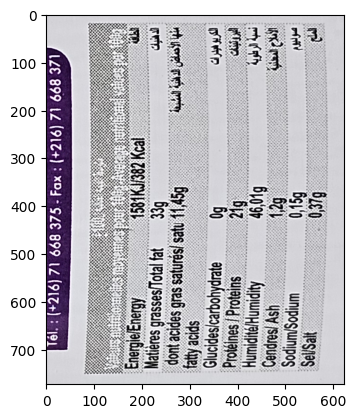


0: 480x640 1 Product, 9.2ms
Speed: 3.0ms preprocess, 9.2ms inference, 2.2ms postprocess per image at shape (1, 3, 480, 640)
<class 'numpy.ndarray'>


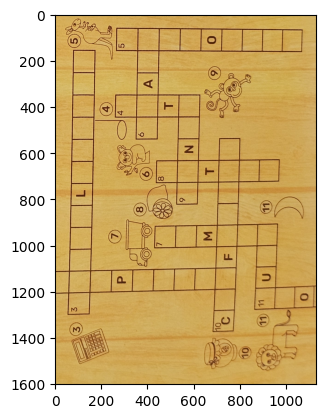


0: 480x640 (no detections), 9.9ms
Speed: 3.2ms preprocess, 9.9ms inference, 0.7ms postprocess per image at shape (1, 3, 480, 640)
An error occurred: list index out of range
<class 'bool'>

0: 480x640 1 Product, 8.9ms
Speed: 3.2ms preprocess, 8.9ms inference, 2.1ms postprocess per image at shape (1, 3, 480, 640)
<class 'numpy.ndarray'>


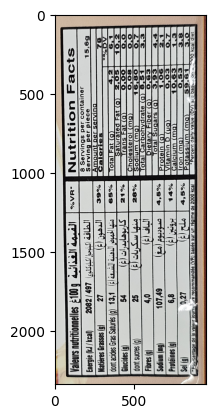


0: 480x640 (no detections), 9.4ms
Speed: 3.2ms preprocess, 9.4ms inference, 0.7ms postprocess per image at shape (1, 3, 480, 640)
An error occurred: list index out of range
<class 'bool'>

0: 480x640 1 Product, 9.0ms
Speed: 3.1ms preprocess, 9.0ms inference, 2.0ms postprocess per image at shape (1, 3, 480, 640)
<class 'numpy.ndarray'>


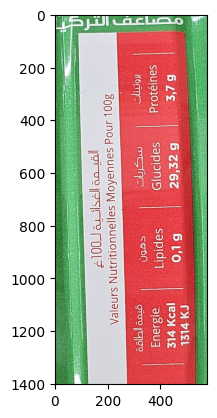


0: 480x640 (no detections), 9.6ms
Speed: 3.2ms preprocess, 9.6ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)
An error occurred: list index out of range
<class 'bool'>

0: 480x640 2 Products, 9.5ms
Speed: 3.2ms preprocess, 9.5ms inference, 1.7ms postprocess per image at shape (1, 3, 480, 640)
<class 'numpy.ndarray'>


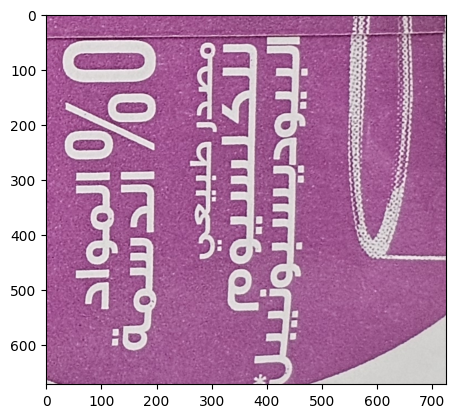


0: 480x640 1 Product, 9.1ms
Speed: 3.0ms preprocess, 9.1ms inference, 2.1ms postprocess per image at shape (1, 3, 480, 640)
<class 'numpy.ndarray'>


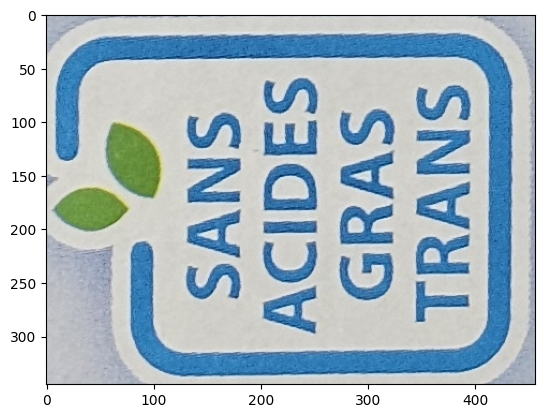


0: 480x640 (no detections), 10.2ms
Speed: 3.3ms preprocess, 10.2ms inference, 0.7ms postprocess per image at shape (1, 3, 480, 640)
An error occurred: list index out of range
<class 'bool'>

0: 480x640 (no detections), 11.1ms
Speed: 3.7ms preprocess, 11.1ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)
An error occurred: list index out of range
<class 'bool'>

0: 480x640 (no detections), 9.8ms
Speed: 3.2ms preprocess, 9.8ms inference, 0.7ms postprocess per image at shape (1, 3, 480, 640)
An error occurred: list index out of range
<class 'bool'>

0: 480x640 1 Product, 9.4ms
Speed: 3.2ms preprocess, 9.4ms inference, 2.2ms postprocess per image at shape (1, 3, 480, 640)
<class 'numpy.ndarray'>


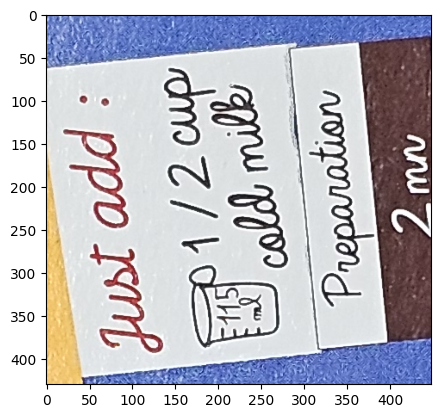


0: 480x640 2 Products, 9.3ms
Speed: 4.2ms preprocess, 9.3ms inference, 1.7ms postprocess per image at shape (1, 3, 480, 640)
<class 'numpy.ndarray'>


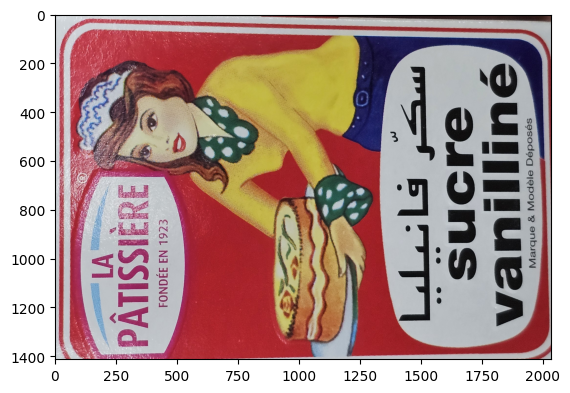


0: 480x640 1 Product, 9.1ms
Speed: 3.2ms preprocess, 9.1ms inference, 2.0ms postprocess per image at shape (1, 3, 480, 640)
<class 'numpy.ndarray'>


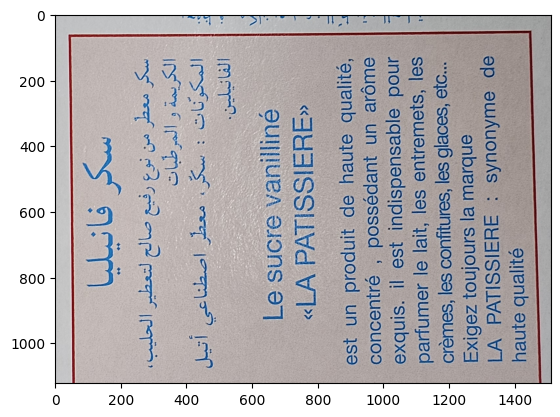


0: 480x640 3 Products, 9.3ms
Speed: 4.1ms preprocess, 9.3ms inference, 2.3ms postprocess per image at shape (1, 3, 480, 640)
<class 'numpy.ndarray'>


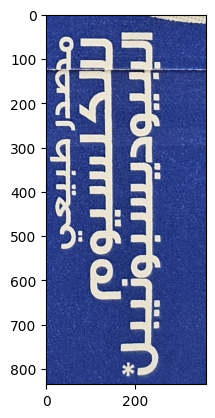


0: 480x640 (no detections), 10.9ms
Speed: 3.5ms preprocess, 10.9ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)
An error occurred: list index out of range
<class 'bool'>

0: 480x640 1 Product, 9.6ms
Speed: 3.3ms preprocess, 9.6ms inference, 2.1ms postprocess per image at shape (1, 3, 480, 640)
<class 'numpy.ndarray'>


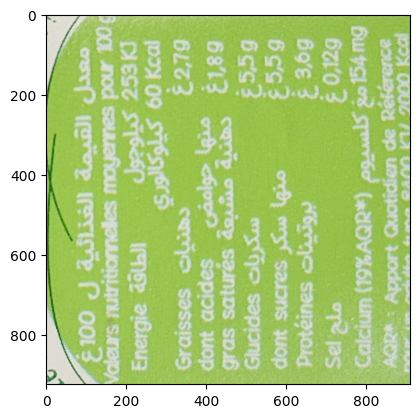


0: 480x640 2 Products, 9.5ms
Speed: 3.0ms preprocess, 9.5ms inference, 2.1ms postprocess per image at shape (1, 3, 480, 640)
<class 'numpy.ndarray'>


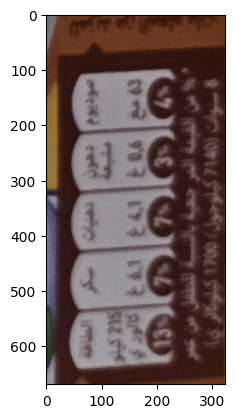


0: 480x640 1 Product, 10.0ms
Speed: 3.4ms preprocess, 10.0ms inference, 1.7ms postprocess per image at shape (1, 3, 480, 640)
<class 'numpy.ndarray'>


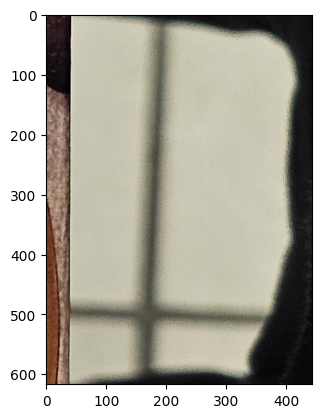


0: 480x640 2 Products, 9.6ms
Speed: 3.1ms preprocess, 9.6ms inference, 2.6ms postprocess per image at shape (1, 3, 480, 640)
<class 'numpy.ndarray'>


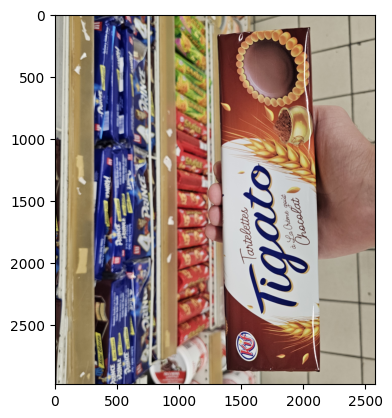


0: 480x640 1 Product, 9.1ms
Speed: 3.9ms preprocess, 9.1ms inference, 2.1ms postprocess per image at shape (1, 3, 480, 640)
<class 'numpy.ndarray'>


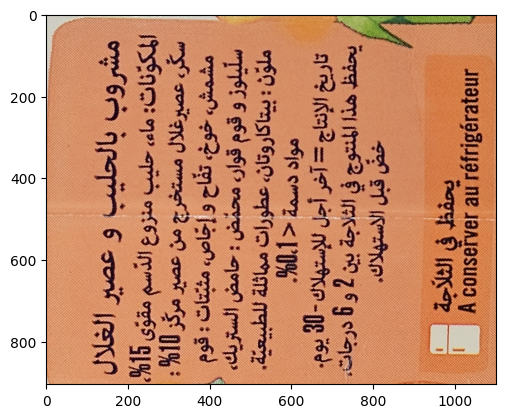


0: 480x640 1 Product, 8.9ms
Speed: 3.1ms preprocess, 8.9ms inference, 2.0ms postprocess per image at shape (1, 3, 480, 640)
<class 'numpy.ndarray'>


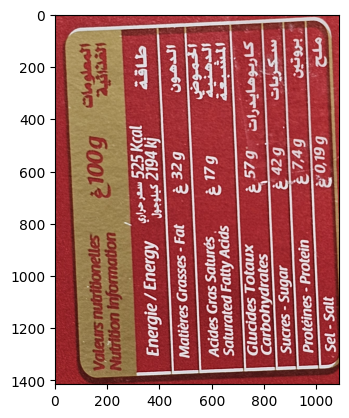


0: 480x640 (no detections), 10.2ms
Speed: 3.3ms preprocess, 10.2ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)
An error occurred: list index out of range
<class 'bool'>

0: 480x640 1 Product, 9.7ms
Speed: 3.3ms preprocess, 9.7ms inference, 2.3ms postprocess per image at shape (1, 3, 480, 640)
<class 'numpy.ndarray'>


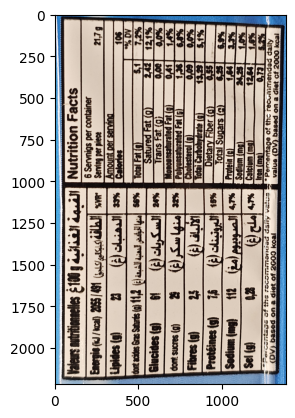


0: 480x640 (no detections), 9.0ms
Speed: 3.1ms preprocess, 9.0ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)
An error occurred: list index out of range
<class 'bool'>

0: 480x640 1 Product, 9.3ms
Speed: 3.1ms preprocess, 9.3ms inference, 2.1ms postprocess per image at shape (1, 3, 480, 640)
<class 'numpy.ndarray'>


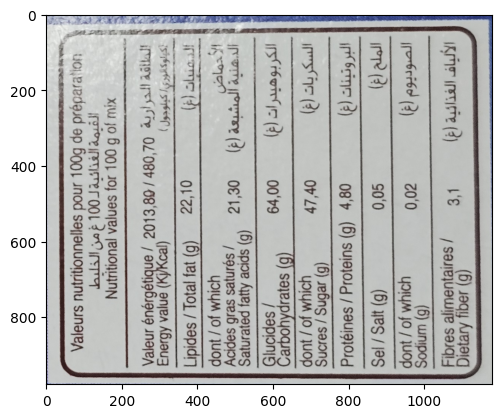


0: 480x640 1 Product, 9.5ms
Speed: 3.1ms preprocess, 9.5ms inference, 2.3ms postprocess per image at shape (1, 3, 480, 640)
<class 'numpy.ndarray'>


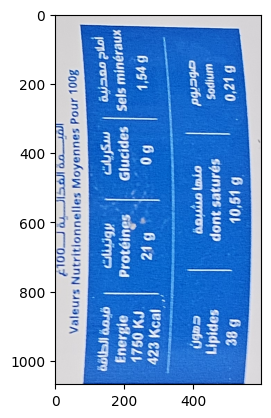


0: 480x640 1 Product, 10.7ms
Speed: 4.2ms preprocess, 10.7ms inference, 2.3ms postprocess per image at shape (1, 3, 480, 640)
<class 'numpy.ndarray'>


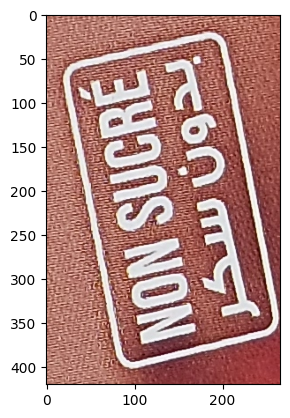


0: 480x640 (no detections), 9.4ms
Speed: 3.2ms preprocess, 9.4ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)
An error occurred: list index out of range
<class 'bool'>

0: 480x640 (no detections), 9.6ms
Speed: 3.0ms preprocess, 9.6ms inference, 0.9ms postprocess per image at shape (1, 3, 480, 640)
An error occurred: list index out of range
<class 'bool'>

0: 480x640 (no detections), 9.2ms
Speed: 4.1ms preprocess, 9.2ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)
An error occurred: list index out of range
<class 'bool'>

0: 480x640 (no detections), 9.1ms
Speed: 2.9ms preprocess, 9.1ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)
An error occurred: list index out of range
<class 'bool'>

0: 480x640 1 Product, 9.3ms
Speed: 3.0ms preprocess, 9.3ms inference, 2.3ms postprocess per image at shape (1, 3, 480, 640)
<class 'numpy.ndarray'>


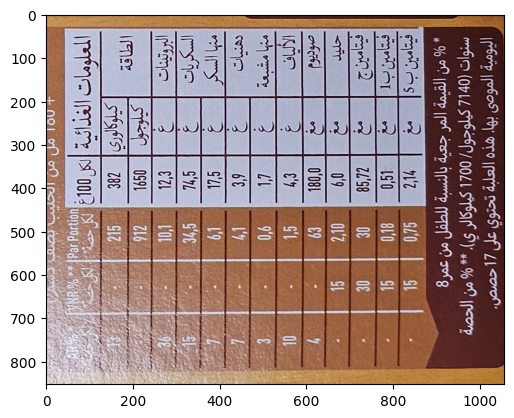


0: 480x640 3 Products, 10.8ms
Speed: 3.4ms preprocess, 10.8ms inference, 3.5ms postprocess per image at shape (1, 3, 480, 640)
<class 'numpy.ndarray'>


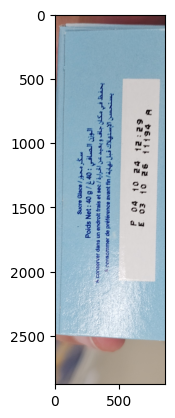


0: 480x640 (no detections), 9.4ms
Speed: 4.1ms preprocess, 9.4ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)
An error occurred: list index out of range
<class 'bool'>

0: 480x640 1 Product, 9.1ms
Speed: 3.0ms preprocess, 9.1ms inference, 2.1ms postprocess per image at shape (1, 3, 480, 640)
<class 'numpy.ndarray'>


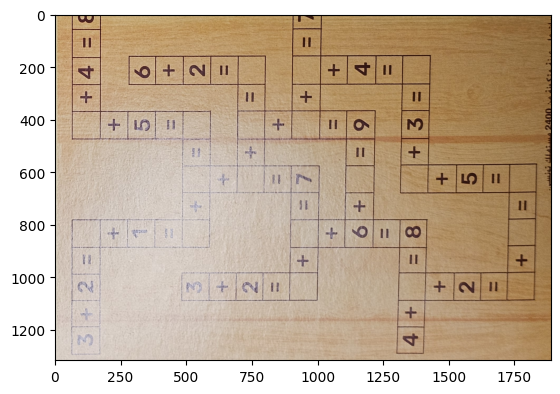


0: 480x640 2 Products, 9.1ms
Speed: 3.9ms preprocess, 9.1ms inference, 2.6ms postprocess per image at shape (1, 3, 480, 640)
<class 'numpy.ndarray'>


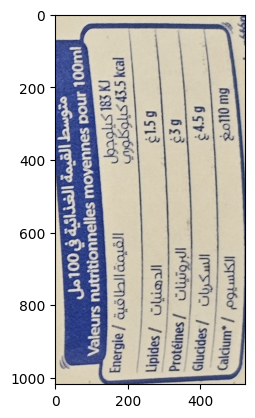


0: 480x640 1 Product, 9.7ms
Speed: 3.1ms preprocess, 9.7ms inference, 2.0ms postprocess per image at shape (1, 3, 480, 640)
<class 'numpy.ndarray'>


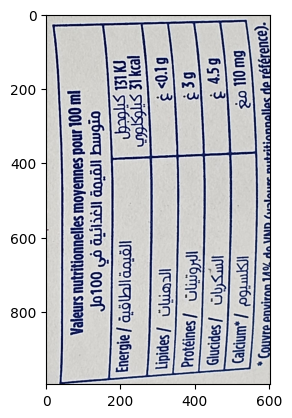


0: 480x640 (no detections), 9.5ms
Speed: 3.1ms preprocess, 9.5ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)
An error occurred: list index out of range
<class 'bool'>

0: 480x640 1 Product, 9.8ms
Speed: 3.3ms preprocess, 9.8ms inference, 2.2ms postprocess per image at shape (1, 3, 480, 640)
<class 'numpy.ndarray'>


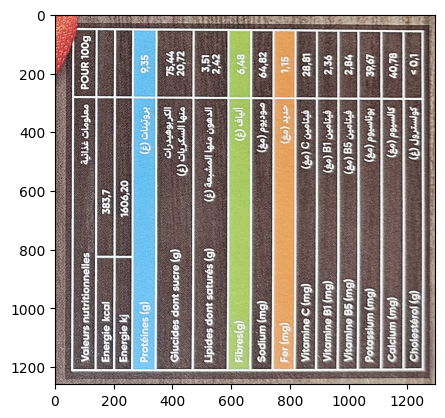


0: 480x640 (no detections), 9.2ms
Speed: 4.2ms preprocess, 9.2ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)
An error occurred: list index out of range
<class 'bool'>

0: 480x640 (no detections), 9.3ms
Speed: 3.1ms preprocess, 9.3ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)
An error occurred: list index out of range
<class 'bool'>

0: 480x640 1 Product, 9.1ms
Speed: 3.0ms preprocess, 9.1ms inference, 2.2ms postprocess per image at shape (1, 3, 480, 640)
<class 'numpy.ndarray'>


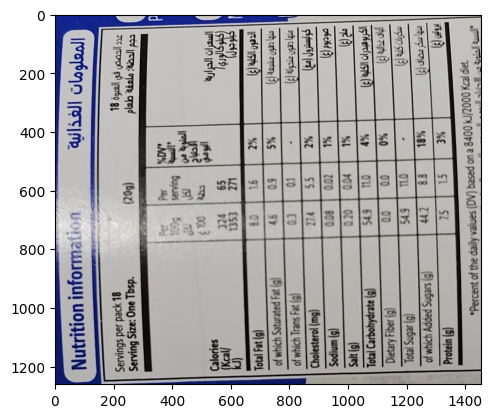


0: 480x640 1 Product, 10.7ms
Speed: 3.3ms preprocess, 10.7ms inference, 2.2ms postprocess per image at shape (1, 3, 480, 640)
<class 'numpy.ndarray'>


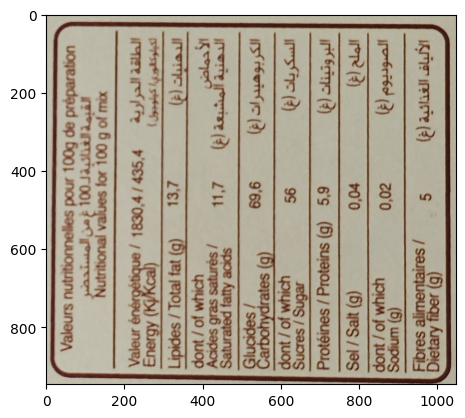


0: 480x640 1 Product, 9.5ms
Speed: 3.2ms preprocess, 9.5ms inference, 2.1ms postprocess per image at shape (1, 3, 480, 640)
<class 'numpy.ndarray'>


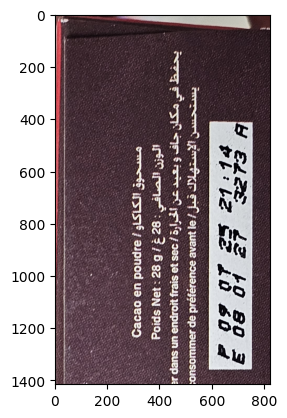


0: 480x640 (no detections), 9.2ms
Speed: 3.8ms preprocess, 9.2ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)
An error occurred: list index out of range
<class 'bool'>

0: 480x640 1 Product, 9.5ms
Speed: 3.2ms preprocess, 9.5ms inference, 2.5ms postprocess per image at shape (1, 3, 480, 640)
<class 'numpy.ndarray'>


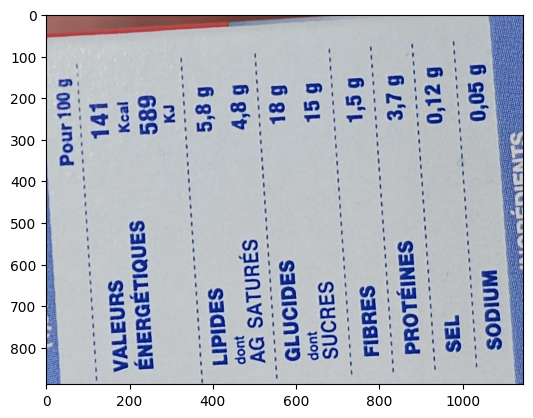


0: 480x640 1 Product, 9.3ms
Speed: 4.0ms preprocess, 9.3ms inference, 2.4ms postprocess per image at shape (1, 3, 480, 640)
<class 'numpy.ndarray'>


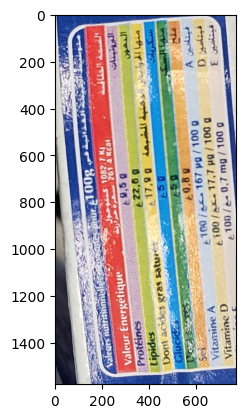

In [ ]:

def draw_image_canny(path):

    new_img =  detect_objects(Image.open(path))
    print(type(new_img))
    if type(new_img) == type(False):
        return

    image = np.array(new_img)

    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Adjust the threshold value (e.g., 127) and max value (e.g., 255) as needed
    #ret, thresh = cv2.threshold(gray, 127, 255, cv2.THRESH_BINARY)

    gray = cv2.bilateralFilter(gray, 5, 20, 20) #cv2.GaussianBlur(gray, (3,3), 0)

    edged = cv2.Canny(gray, 300, 300)

    # Apply binary threshold
    # Find contours


    _, binary = cv2.threshold(edged, 50, 50, cv2.THRESH_BINARY)


    contours, hierarchy = cv2.findContours(edged,
                          cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)

    display_im(image)


#"TunisianProductsImages/20251107_203219.jpg"

for it in os.listdir("TunisianProductsImages"):
    draw_image_canny("TunisianProductsImages/" + str(it))


def dsstest():
# Iterate through contours and crop
    for i, contour in enumerate(contours):
        # Get the bounding rectangle
        x, y, w, h = cv2.boundingRect(contour)

        # Crop the image
        cropped_object = image[y:y+h, x:x+w]

        # Save or display the cropped image
        cv2.imwrite(f'cropped_object_{i}.jpg', cropped_object)

        display_im(cropped_object)
        # cv2.imshow(f'Cropped Object {i}', cropped_object)


In [ ]:
def display_im(new_img):
    plt.figure()
    plt.imshow(new_img)
    plt.show()


0: 480x640 1 Product, 12.1ms
Speed: 3.2ms preprocess, 12.1ms inference, 2.1ms postprocess per image at shape (1, 3, 480, 640)
<PIL.Image.Image image mode=RGB size=4000x3000 at 0x7AA74DD4D810>


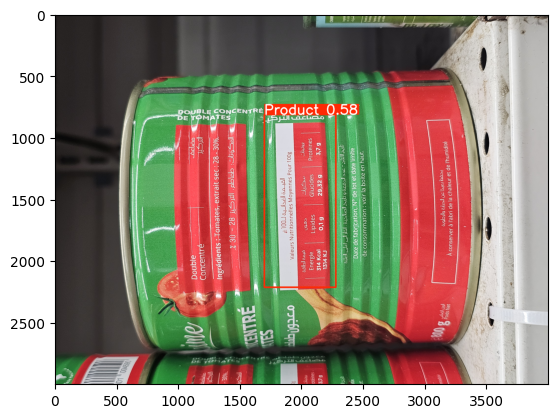

In [ ]:
from flask import Flask, request, jsonify, send_file
from ultralytics import YOLO
import cv2
import numpy as np
from PIL import Image
import io
import base64
import os

app = Flask(__name__)

# Load the YOLO model
model = YOLO('my_custom_yolo_model.pt')

@app.route('/health', methods=['GET'])
def health_check():
    """Health check endpoint"""
    return jsonify({"status": "healthy", "model_loaded": True})

#@app.route('/detect', methods=['POST'])
def detect_objects(image):
    """
    Detect objects in uploaded image and return image with bounding boxes
    """
    try:
        # Check if image file is present
        #if 'image' not in request.files:
        #    return jsonify({"error": "No image file provided"}), 400

        #file = request.files['image']
        #if file.filename == '':
        #    return jsonify({"error": "No image file selected"}), 400

        # Read image
        #image_bytes = file.read()
        #image = Image.open(io.BytesIO(image_bytes))





        # Convert PIL image to numpy array for YOLO
        image_np = np.array(image)

        # Run YOLO detection
        results = model(image_np)

        # Get the first result (assuming single image)
        result = results[0]

        #cropped_img = image.crop(tuple(result.boxes.xyxy.tolist()[0]))

        #cropped_img = np.array(cropped_img)
          # Draw bounding boxes on the image
        annotated_image = result.plot()

        # Convert back to PIL Image
        annotated_pil = Image.fromarray(annotated_image)

        # Save to bytes
        img_buffer = io.BytesIO()
        annotated_pil.save(img_buffer, format='JPEG')
        img_buffer.seek(0)

        return annotated_pil # annotated_image # annotated_image


    except Exception as e:
        print(f"An error occurred: {e}")
        return False
        #return jsonify({"error": str(e)}), 500


new_img =  detect_objects(Image.open("TunisianProductsImages/20251107_203219.jpg"))
#if __name__ == '__main__':
    #app.run(debug=True, host='0.0.0.0', port=5000)

print(new_img)
plt.figure()
plt.imshow(new_img)
plt.show()